# Week 6 A
## Name: Jay Zhang
To solve the question: "What are the genetic factors related to Rectal Cancer when considering the influence of weight?"

### 1. Data Preprocessing

In [70]:
!pip3 install sparse_lmm
!pip3 install statsmodels
!pip3 install pandas
!pip3 install numpy
!pip3 install seaborn


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip


In [2]:
# Read file
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sparse_lmm import VariableSelection
clinical_data = pd.read_csv('/Users/kitkatj/Downloads/ai4science/TCGA dataset/TCGA_Rectal_Cancer_(READ)/TCGA.READ.sampleMap_READ_clinicalMatrix', sep='\t', index_col=0)
gene_data = pd.read_csv('/Users/kitkatj/Downloads/ai4science/TCGA dataset/TCGA_Rectal_Cancer_(READ)/TCGA.READ.sampleMap_HiSeqV2_PANCAN', sep='\t', index_col=0)
pd.options.display.max_columns = None

In [3]:
# Display clinical dataset
clinical_data.head()

,AWG_MLH1_silencing,AWG_cancer_type_Oct62011,CDE_ID_3226963,CIMP,MSI_updated_Oct62011,_INTEGRATION,_PANCAN_CNA_PANCAN_K8,_PANCAN_Cluster_Cluster_PANCAN,_PANCAN_DNAMethyl_PANCAN,_PANCAN_RPPA_PANCAN_K8,_PANCAN_UNC_RNAseq_PANCAN_K16,_PANCAN_miRNA_PANCAN,_PANCAN_mirna_READ,_PANCAN_mutation_PANCAN,_PATIENT,_cohort,_primary_disease,_primary_site,additional_pharmaceutical_therapy,additional_radiation_therapy,age_at_initial_pathologic_diagnosis,anatomic_neoplasm_subdivision,bcr_followup_barcode,bcr_patient_barcode,bcr_sample_barcode,braf_gene_analysis_performed,braf_gene_analysis_result,circumferential_resection_margin,colon_polyps_present,days_to_birth,days_to_collection,days_to_death,days_to_initial_pathologic_diagnosis,days_to_last_followup,days_to_new_tumor_event_additional_surgery_procedure,days_to_new_tumor_event_after_initial_treatment,followup_case_report_form_submission_reason,followup_treatment_success,form_completion_date,gender,height,histological_type,history_of_colon_polyps,history_of_neoadjuvant_treatment,hypermutation,icd_10,icd_o_3_histology,icd_o_3_site,informed_consent_verified,initial_weight,intermediate_dimension,is_ffpe,kras_gene_analysis_performed,kras_mutation_codon,kras_mutation_found,longest_dimension,loss_expression_of_mismatch_repair_proteins_by_ihc,loss_expression_of_mismatch_repair_proteins_by_ihc_result,lost_follow_up,lymph_node_examined_count,lymphatic_invasion,microsatellite_instability,new_neoplasm_event_type,new_tumor_event_additional_surgery_procedure,new_tumor_event_after_initial_treatment,non_nodal_tumor_deposits,non_silent_mutation,non_silent_rate_per_Mb,number_of_abnormal_loci,number_of_first_degree_relatives_with_cancer_diagnosis,number_of_loci_tested,number_of_lymphnodes_positive_by_he,number_of_lymphnodes_positive_by_ihc,oct_embedded,pathologic_M,pathologic_N,pathologic_T,pathologic_stage,pathology_report_file_name,patient_id,perineural_invasion_present,person_neoplasm_cancer_status,postoperative_rx_tx,preoperative_pretreatment_cea_level,primary_lymph_node_presentation_assessment,primary_therapy_outcome_success,radiation_therapy,residual_disease_post_new_tumor_event_margin_status,residual_tumor,sample_type,sample_type_id,shortest_dimension,silent_mutation,silent_rate_per_Mb,site_of_additional_surgery_new_tumor_event_mets,synchronous_colon_cancer_present,system_version,tissue_prospective_collection_indicator,tissue_retrospective_collection_indicator,tissue_source_site,total_mutation,tumor_tissue_site,venous_invasion,vial_number,vital_status,weight,year_of_initial_pathologic_diagnosis,_GENOMIC_ID_TCGA_READ_RPPA,_GENOMIC_ID_TCGA_READ_G4502A_07_3,_GENOMIC_ID_TCGA_READ_exp_HiSeqV2,_GENOMIC_ID_TCGA_READ_PDMarrayCNV,_GENOMIC_ID_TCGA_READ_PDMRNAseq,_GENOMIC_ID_TCGA_READ_miRNA_GA,_GENOMIC_ID_TCGA_READ_exp_GAV2,_GENOMIC_ID_TCGA_READ_PDMRNAseqCNV,_GENOMIC_ID_TCGA_READ_hMethyl27,_GENOMIC_ID_TCGA_READ_miRNA_HiSeq,_GENOMIC_ID_TCGA_READ_exp_HiSeqV2_PANCAN,_GENOMIC_ID_TCGA_READ_mutation_bcm_gene,_GENOMIC_ID_TCGA_READ_hMethyl450,_GENOMIC_ID_TCGA_READ_gistic2,_GENOMIC_ID_TCGA_READ_RPPA_RBN,_GENOMIC_ID_data/public/TCGA/READ/miRNA_HiSeq_gene,_GENOMIC_ID_TCGA_READ_PDMarray,_GENOMIC_ID_data/public/TCGA/READ/miRNA_GA_gene,_GENOMIC_ID_TCGA_READ_gistic2thd,_GENOMIC_ID_TCGA_READ_exp_GAV2_exon,_GENOMIC_ID_TCGA_READ_mutation_bcm_solid_gene,_GENOMIC_ID_TCGA_READ_exp_HiSeqV2_percentile,_GENOMIC_ID_TCGA_READ_exp_HiSeqV2_exon
sampleID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
TCGA-AF-2687-01,NaN,NaN,MSS,NaN,NaN,TCGA-AF-2687-01,COAD-READ,NaN,COADREAD non-CIMP c11,NaN,NaN,miRNA cluster 5,NaN,NaN,TCGA-AF-2687,TCGA Rectal Cancer (READ),rectum adenocarcinoma,Rectum,NO,NO,57.0,Rectum,TCGA-AF-2687-F40084,TCGA-AF-2687,NaN,NO,NaN,NaN,NO,-21098.0,NaN,NaN,0.0,1427.0,NaN,1267.0,Scheduled Follow-up Submission,Complete Remission/Response,2013-2-13,MALE,163.0,Rectal Adenocarcinoma,NO,No,NaN,C19,8140/3,C19.9,YES,NaN,NaN,NaN,NO,NaN,NaN,NaN,NaN,NaN,NO,16.

In [4]:
# Display gene dataset
gene_data.head()

,TCGA-DC-6156-01,TCGA-DC-6160-01,TCGA-EI-6512-01,TCGA-DC-5869-01,TCGA-EI-6507-01,TCGA-AF-3911-01,TCGA-EI-7004-01,TCGA-G5-6572-01,TCGA-EF-5830-01,TCGA-F5-6812-01,TCGA-CI-6624-01,TCGA-AG-3902-01,TCGA-EF-5831-01,TCGA-AG-3731-01,TCGA-AF-A56L-01,TCGA-DT-5265-01,TCGA-F5-6465-01,TCGA-AH-6547-01,TCGA-F5-6811-01,TCGA-F5-6571-01,TCGA-AH-6903-01,TCGA-DC-6682-01,TCGA-AF-6672-01,TCGA-EI-7002-01,TCGA-BM-6198-01,TCGA-F5-6864-01,TCGA-EI-6881-01,TCGA-DC-5337-01,TCGA-G5-6235-01,TCGA-G5-6572-02,TCGA-DC-6681-01,TCGA-EI-6511-01,TCGA-F5-6464-01,TCGA-EI-6509-01,TCGA-AH-6897-01,TCGA-EI-6508-01,TCGA-AH-6544-01,TCGA-DY-A1H8-01,TCGA-AF-2693-01,TCGA-AF-5654-11,TCGA-CI-6622-01,TCGA-EI-6882-01,TCGA-AH-6643-11,TCGA-DY-A1DC-01,TCGA-EI-6884-01,TCGA-AF-5654-01,TCGA-AG-3725-11,TCGA-AG-4021-01,TCGA-CL-5917-01,TCGA-AF-6136-01,TCGA-AG-3742-01,TCGA-DC-6155-01,TCGA-F5-6814-01,TCGA-F5-6702-01,TCGA-CI-6623-01,TCGA-AF-A56N-01,TCGA-G5-6641-01,TCGA-AF-2690-01,TCGA-F5-6861-01,TCGA-AH-6549-01,TCGA-EI-6510-01,TCGA-AF-6655-01,TCGA-AH-6644-01,TCGA-DY-A1DG-01,TCGA-DC-6158-01,TCGA-CL-4957-01,TCGA-CL-5918-01,TCGA-CI-6621-01,TCGA-AG-3742-11,TCGA-DC-4749-01,TCGA-DC-6683-01,TCGA-DC-4745-01,TCGA-CI-6619-01,TCGA-DY-A1DE-01,TCGA-EI-6885-01,TCGA-G5-6233-01,TCGA-AG-3732-11,TCGA-AG-3731-11,TCGA-DC-6157-01,TCGA-DY-A1DF-01,TCGA-F5-6813-01,TCGA-AF-4110-01,TCGA-EI-6514-01,TCGA-EI-6513-01,TCGA-AF-2689-11,TCGA-AF-2687-01,TCGA-DY-A1DD-01,TCGA-F5-6863-01,TCGA-F5-6810-01,TCGA-AG-3591-01,TCGA-EI-6917-01,TCGA-AF-2691-11,TCGA-EI-6883-01,TCGA-AG-4022-01,TCGA-AG-3732-01,TCGA-CI-6620-01,TCGA-AG-3725-01,TCGA-AH-6643-01,TCGA-DY-A0XA-01,TCGA-AF-3400-11,TCGA-EI-6506-01,TCGA-AF-2692-11,TCGA-AF-A56K-01,TCGA-DC-6154-01,TCGA-AG-3592-01
sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ARHGEF10L,0.335208,0.452908,1.179008,0.163108,0.126508,1.096808,0.552108,0.848808,1.359908,1.343608,0.787008,1.342508,0.828708,0.545108,1.160108,0.934308,1.254508,0.904708,0.422708,1.376308,1.151508,0.471308,1.150808,1.117208,0.871208,1.071308,1.359908,-0.061692,0.803208,0.980908,0.440408,0.234408,0.587008,2.097508,0.904708,1.221908,0.884208,0.538608,0.172208,1.230408,0.452608,0.713008,0.843208,0.924608,1.482108,1.138208,0.856008,0.845808,0.816308,0.881708,0.931108,-1.317492,0.705708,0.473008,0.640808,1.280308,0.913208,0.378808,1.755208,0.945808,1.576008,0.917308,-0.108392,2.063608,0.826508,1.337108,1.348408,0.513808,0.445608,0.524608,0.037408,0.538108,0.904808,1.342108,1.122008,0.836008,0.618508,1.319608,1.254508,2.668408,0.488308,0.737508,1.007608,1.494908,0.975608,0.410908,1.181108,1.990108,0.748308,0.754608,1.244208,0.882608,1.635808,1.215908,1.967508,1.045008,1.399708,0.491908,0.630708,1.540308,1.454808,0.869808,0.855608,1.480208,0.911308
HIF3A,-1.158126,-2.582626,-0.892726,0.122474,-0.709026,-1.862026,-1.704726,1.253474,-1.331526,-0.012826,0.306774,-2.270226,-3.611626,-1.224526,-0.738626,-0.477426,0.285374,-0.576926,-0.833626,-0.929226,-2.156626,-0.871126,-2.714126,-1.292026,-1.295826,0.734674,-4.802826,1.626774,-1.726726,-0.097826,-0.669426,-2.683026,-0.105026,-0.092026,-2.179726,-1.162026,-2.611926,-1.996426,-1.749126,0.835674,-0.740726,-3.407226,2.506274,-1.613926,-1.704426,-3.659326,1.090874,-2.190526,-2.102526,-2.262826,-3.771726,-1.968826,-0.436326,-0.537126,-1.704926,2.459774,-0.364626,-0.220626,-1.862726,-0.051526,-0.917226,-2.224926,-2.235026,2.533874,-1.516026,0.512774,-1.474126,-0.379926,2.909674,-1.592326,-0.990326,-3.486626,2.073274,-0.353526,2.012174,-0.557526,3.136374,2.301474,-1.911526,-0.680626,-1.068826,-1.314426,0.222974,-0.447226,2.391874,2.396474,0.120074,0.987474,1.978074,-2.519026,-1.279826,1.743474,-1.503226,0.619374,0.272674,-2.231326,-4.127526,-3.238526,-2.453226,0.209774,-2.553926,2.152274,1.167674,0.547374,-0.467126
RNF17,-0.531035,-0.531035,-0.010835,-0.531035,-0.531035,-0.531035,-0.012135,-0.531035,-0.531035,-0.531035,-0.531035,-0.531035,-0.531035,-0.531035,-0.531035,-0.531035,-0.073935,0.046265,0.737865,0.609265,-0.531035,0.100165,-

In [5]:
# Set Basic info
trait = 'Rectal Cancer'
condition = 'weight'
condition_col = 'weight'
gene_list = gene_data.index.tolist()
# Get the feature dimension of clinical data, and the number of genes
col_offset = len(clinical_data.columns)
num_genes = len(gene_list)
print(f'The clinical dataset has {col_offset} features, and the gene dataset includes {num_genes} genes')

The clinical dataset has 130 features, and the gene dataset includes 20530 genes


In [6]:
# Merge clinical_data and gene_data on their indices - sample_ID, corresponding to each person
merged_data = clinical_data.join(gene_data.T)
merged_data.head()

,AWG_MLH1_silencing,AWG_cancer_type_Oct62011,CDE_ID_3226963,CIMP,MSI_updated_Oct62011,_INTEGRATION,_PANCAN_CNA_PANCAN_K8,_PANCAN_Cluster_Cluster_PANCAN,_PANCAN_DNAMethyl_PANCAN,_PANCAN_RPPA_PANCAN_K8,_PANCAN_UNC_RNAseq_PANCAN_K16,_PANCAN_miRNA_PANCAN,_PANCAN_mirna_READ,_PANCAN_mutation_PANCAN,_PATIENT,_cohort,_primary_disease,_primary_site,additional_pharmaceutical_therapy,additional_radiation_therapy,age_at_initial_pathologic_diagnosis,anatomic_neoplasm_subdivision,bcr_followup_barcode,bcr_patient_barcode,bcr_sample_barcode,braf_gene_analysis_performed,braf_gene_analysis_result,circumferential_resection_margin,colon_polyps_present,days_to_birth,days_to_collection,days_to_death,days_to_initial_pathologic_diagnosis,days_to_last_followup,days_to_new_tumor_event_additional_surgery_procedure,days_to_new_tumor_event_after_initial_treatment,followup_case_report_form_submission_reason,followup_treatment_success,form_completion_date,gender,height,histological_type,history_of_colon_polyps,history_of_neoadjuvant_treatment,hypermutation,icd_10,icd_o_3_histology,icd_o_3_site,informed_consent_verified,initial_weight,intermediate_dimension,is_ffpe,kras_gene_analysis_performed,kras_mutation_codon,kras_mutation_found,longest_dimension,loss_expression_of_mismatch_repair_proteins_by_ihc,loss_expression_of_mismatch_repair_proteins_by_ihc_result,lost_follow_up,lymph_node_examined_count,lymphatic_invasion,microsatellite_instability,new_neoplasm_event_type,new_tumor_event_additional_surgery_procedure,new_tumor_event_after_initial_treatment,non_nodal_tumor_deposits,non_silent_mutation,non_silent_rate_per_Mb,number_of_abnormal_loci,number_of_first_degree_relatives_with_cancer_diagnosis,number_of_loci_tested,number_of_lymphnodes_positive_by_he,number_of_lymphnodes_positive_by_ihc,oct_embedded,pathologic_M,pathologic_N,pathologic_T,pathologic_stage,pathology_report_file_name,patient_id,perineural_invasion_present,person_neoplasm_cancer_status,postoperative_rx_tx,preoperative_pretreatment_cea_level,primary_lymph_node_presentation_assessment,primary_therapy_outcome_success,radiation_therapy,residual_disease_post_new_tumor_event_margin_status,residual_tumor,sample_type,sample_type_id,shortest_dimension,silent_mutation,silent_rate_per_Mb,site_of_additional_surgery_new_tumor_event_mets,synchronous_colon_cancer_present,system_version,tissue_prospective_collection_indicator,tissue_retrospective_collection_indicator,tissue_source_site,total_mutation,tumor_tissue_site,venous_invasion,vial_number,vital_status,weight,year_of_initial_pathologic_diagnosis,_GENOMIC_ID_TCGA_READ_RPPA,_GENOMIC_ID_TCGA_READ_G4502A_07_3,_GENOMIC_ID_TCGA_READ_exp_HiSeqV2,_GENOMIC_ID_TCGA_READ_PDMarrayCNV,_GENOMIC_ID_TCGA_READ_PDMRNAseq,_GENOMIC_ID_TCGA_READ_miRNA_GA,_GENOMIC_ID_TCGA_READ_exp_GAV2,_GENOMIC_ID_TCGA_READ_PDMRNAseqCNV,_GENOMIC_ID_TCGA_READ_hMethyl27,_GENOMIC_ID_TCGA_READ_miRNA_HiSeq,_GENOMIC_ID_TCGA_READ_exp_HiSeqV2_PANCAN,_GENOMIC_ID_TCGA_READ_mutation_bcm_gene,_GENOMIC_ID_TCGA_READ_hMethyl450,_GENOMIC_ID_TCGA_READ_gistic2,_GENOMIC_ID_TCGA_READ_RPPA_RBN,_GENOMIC_ID_data/public/TCGA/READ/miRNA_HiSeq_gene,_GENOMIC_ID_TCGA_READ_PDMarray,_GENOMIC_ID_data/public/TCGA/READ/miRNA_GA_gene,_GENOMIC_ID_TCGA_READ_gistic2thd,_GENOMIC_ID_TCGA_READ_exp_GAV2_exon,_GENOMIC_ID_TCGA_READ_mutation_bcm_solid_gene,_GENOMIC_ID_TCGA_READ_exp_HiSeqV2_percentile,_GENOMIC_ID_TCGA_READ_exp_HiSeqV2_exon,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC

In [7]:
# Only select relevant columns
feature_cols = [condition_col] + gene_list
merged_data = merged_data[feature_cols]

# Remove sample rows with missing columns.
threshold_rows = 0.8 * len(merged_data)
rows_after_any = len(merged_data.dropna(how='any'))

# Prefer "how='any'", if it does not discard too much data.
if rows_after_any >= threshold_rows:
    merged_data = merged_data.dropna(how='any')
else:
    merged_data = merged_data.dropna(how='all')
    merged_data = merged_data.fillna(0)

# delete all 0 value entrance
merged_data = merged_data.loc[merged_data[condition_col] != 0]
merged_data.head()

,weight,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,LOC283070,SIX6,PM20D1,MR1,MGC4473,SIX3,SNORD115-4,WASH3P,CNPY4,CNPY3,CNPY2,CNPY1,NODAL,SYNJ1,KNDC1,HMG20A,HMG20B,PHOSPHO2,AAGAB,C4orf19,C3orf79,SLC7A6OS,C3orf77,C3orf75,C3orf74,C4orf10,C3orf72,C3orf71,C3orf70,ZNF285,MRO,ZFP82,CHFR,EFHA1,RTBDN,EFHA2,AAA1,GPR75,NUDT9P1,SYPL2,RFX8,ZNF222,RFX4,OR2C3,AVPR2,RFX7,NRXN3,GPR77,NRXN1,RFX3,SNORD104,RFPL2,VPS37D,NLRP13,APC,TMEM179B,ABCE1,UQCRC2,XPNPEP1,XPNPEP2,TIGD4,ZNHIT3,GGCX,PAPLN,ADNP,TMEM218,STXBP6,KHDRBS1,RUNDC2C,KHDRBS3,GGCT,VPS37C,STAC2,LOC283404,ZNF395,STAC3,TBL1Y,LHCGR,TMEM211,OR1Q1,TMEM127,GPR78,TRPA1,VPS37B,TTC7A,UQCRHL,ZBED4,C11orf2,C11orf1,DPYSL5,DPYSL2,DPYSL3,OSTM1,RUNX2,C11orf9,KRTAP10-12,KRTAP10-11,KRTAP10-10,IGFBP2,IGFBP3,IGFBP1,BOP1,IGFBP7,IGFBP4,IGFBP5,SKP2,TTC4,CYP2R1,CKLF,ZNF193,C15orf26,C15orf27,C15orf24,GJA3,APLNR,C15orf23,C15orf21,GJA8,CYP8B1,C15orf28,C15orf29,STMN1,S1PR2,KDM3B,REG1P,STK17A,KDM3A,LOC401387,S1PR1,ZNF642,TMC4,MYO3A,TMC6,KIAA1958,APIP,TMC1,GPR15,TMC3,PKLR,TECRL,EIF2B4,EIF2B5,EIF2B2,EIF2B3,EIF2B1,PRKAR2A,CSNK2A1P,XRRA1,C20orf56,C20orf54,TXNIP,SLC36A4,LOC389791,ZNF876P,MLF1,QPRT,IFT140,MLF2,TMEM14C,FAM157A,FAM157B,FANCF,MECOM,ITGA2B,RSPH1,IFI16,SOX6,LOC440944,TTC1,C9orf128,C9orf129,MYT1L,C9orf125,C9orf122,CEPT1,KIAA1267,RTCD1,CFHR2,CFHR3,CLIC4,CLIC5,CLIC2,CLIC3,CFHR4,CFHR5,KRTAP2-2,KRTAP2-1,CXorf1,KIAA0020,KRTAP2-4,TMEM147,ASGR1,ASGR2,PCDHA1,FOXL2,RIT1,TMEM141,FOXL1,SF1,PCDHA6,PKIB,TMEM149,API5,KRTCAP3,NUMBL,RTKN2,RNF180,P2RX7,SECISBP2L,SBF1P1,LOC100128811,HAS2,KIAA1199,HLA-DPA1,ZSWIM3,FAM32A,KIAA1191,FER1L6,ALOX12P2,FER1L4,FER1L5,CA5B,ZNF559,VWA1,C19orf22,C19orf23,C19orf20,C19orf21,C19orf26,ZMAT4,C19orf24,C19orf25,MYBL1,NR1D1,C19orf28,C19orf29,ITGB1BP1,ITGB1BP3,ITGB1BP2,ZNF7,ZNF2,ZNF3,CTCFL,PHLDA1,RPL31,ZNF8,PCP4L1,C11orf17,C11orf16,ZAP70,SNORD115-9,C11orf10,ZCCHC13,UFSP2,OGFR,EPM2AIP1,CDC5L,RAC2,RAC3,RAC1,SBDS,RCL1,SBK2,MRPS18A,CPLX2,CPLX3,ORC3L,CPLX1,AP2

In [8]:
# Decode the trait information from Sample IDs. Tumor types range from 01 - 09, normal types from 10 - 19.
# Create a function to check the last two digits of a row index

def mark_tumor(row_index):
    last_two_digits = int(row_index[-2:])
    
    mapping = {
        (1, 9): 1,
        (10, 19): 0
    }
    
    return next((value for (start, end), value in mapping.items() if start <= last_two_digits <= end), -1)


# Use the apply function to add the trait column to merged_data
merged_data[trait] = merged_data.index.to_series().apply(mark_tumor)

merged_data.head()

,weight,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,LOC283070,SIX6,PM20D1,MR1,MGC4473,SIX3,SNORD115-4,WASH3P,CNPY4,CNPY3,CNPY2,CNPY1,NODAL,SYNJ1,KNDC1,HMG20A,HMG20B,PHOSPHO2,AAGAB,C4orf19,C3orf79,SLC7A6OS,C3orf77,C3orf75,C3orf74,C4orf10,C3orf72,C3orf71,C3orf70,ZNF285,MRO,ZFP82,CHFR,EFHA1,RTBDN,EFHA2,AAA1,GPR75,NUDT9P1,SYPL2,RFX8,ZNF222,RFX4,OR2C3,AVPR2,RFX7,NRXN3,GPR77,NRXN1,RFX3,SNORD104,RFPL2,VPS37D,NLRP13,APC,TMEM179B,ABCE1,UQCRC2,XPNPEP1,XPNPEP2,TIGD4,ZNHIT3,GGCX,PAPLN,ADNP,TMEM218,STXBP6,KHDRBS1,RUNDC2C,KHDRBS3,GGCT,VPS37C,STAC2,LOC283404,ZNF395,STAC3,TBL1Y,LHCGR,TMEM211,OR1Q1,TMEM127,GPR78,TRPA1,VPS37B,TTC7A,UQCRHL,ZBED4,C11orf2,C11orf1,DPYSL5,DPYSL2,DPYSL3,OSTM1,RUNX2,C11orf9,KRTAP10-12,KRTAP10-11,KRTAP10-10,IGFBP2,IGFBP3,IGFBP1,BOP1,IGFBP7,IGFBP4,IGFBP5,SKP2,TTC4,CYP2R1,CKLF,ZNF193,C15orf26,C15orf27,C15orf24,GJA3,APLNR,C15orf23,C15orf21,GJA8,CYP8B1,C15orf28,C15orf29,STMN1,S1PR2,KDM3B,REG1P,STK17A,KDM3A,LOC401387,S1PR1,ZNF642,TMC4,MYO3A,TMC6,KIAA1958,APIP,TMC1,GPR15,TMC3,PKLR,TECRL,EIF2B4,EIF2B5,EIF2B2,EIF2B3,EIF2B1,PRKAR2A,CSNK2A1P,XRRA1,C20orf56,C20orf54,TXNIP,SLC36A4,LOC389791,ZNF876P,MLF1,QPRT,IFT140,MLF2,TMEM14C,FAM157A,FAM157B,FANCF,MECOM,ITGA2B,RSPH1,IFI16,SOX6,LOC440944,TTC1,C9orf128,C9orf129,MYT1L,C9orf125,C9orf122,CEPT1,KIAA1267,RTCD1,CFHR2,CFHR3,CLIC4,CLIC5,CLIC2,CLIC3,CFHR4,CFHR5,KRTAP2-2,KRTAP2-1,CXorf1,KIAA0020,KRTAP2-4,TMEM147,ASGR1,ASGR2,PCDHA1,FOXL2,RIT1,TMEM141,FOXL1,SF1,PCDHA6,PKIB,TMEM149,API5,KRTCAP3,NUMBL,RTKN2,RNF180,P2RX7,SECISBP2L,SBF1P1,LOC100128811,HAS2,KIAA1199,HLA-DPA1,ZSWIM3,FAM32A,KIAA1191,FER1L6,ALOX12P2,FER1L4,FER1L5,CA5B,ZNF559,VWA1,C19orf22,C19orf23,C19orf20,C19orf21,C19orf26,ZMAT4,C19orf24,C19orf25,MYBL1,NR1D1,C19orf28,C19orf29,ITGB1BP1,ITGB1BP3,ITGB1BP2,ZNF7,ZNF2,ZNF3,CTCFL,PHLDA1,RPL31,ZNF8,PCP4L1,C11orf17,C11orf16,ZAP70,SNORD115-9,C11orf10,ZCCHC13,UFSP2,OGFR,EPM2AIP1,CDC5L,RAC2,RAC3,RAC1,SBDS,RCL1,SBK2,MRPS18A,CPLX2,CPLX3,ORC3L,CPLX1,AP2

### 2. Preliminary analysis

Plot the distributions of the target and important regressors

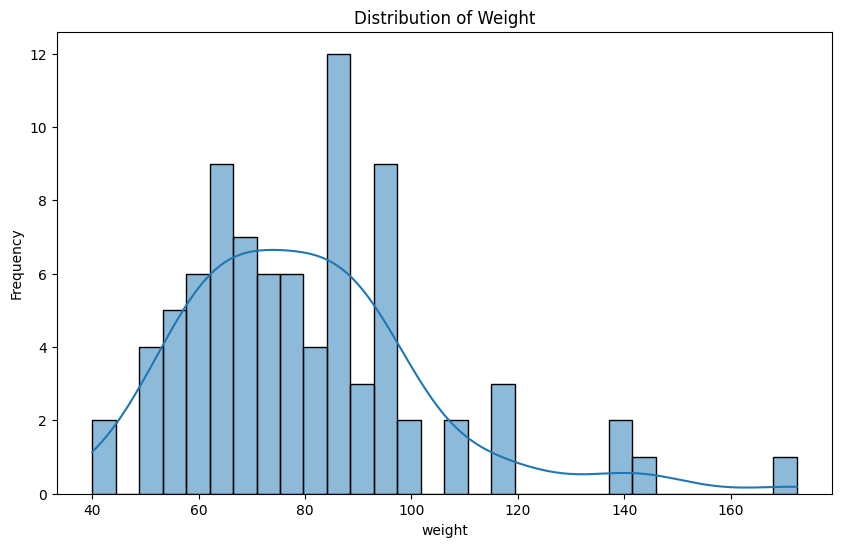

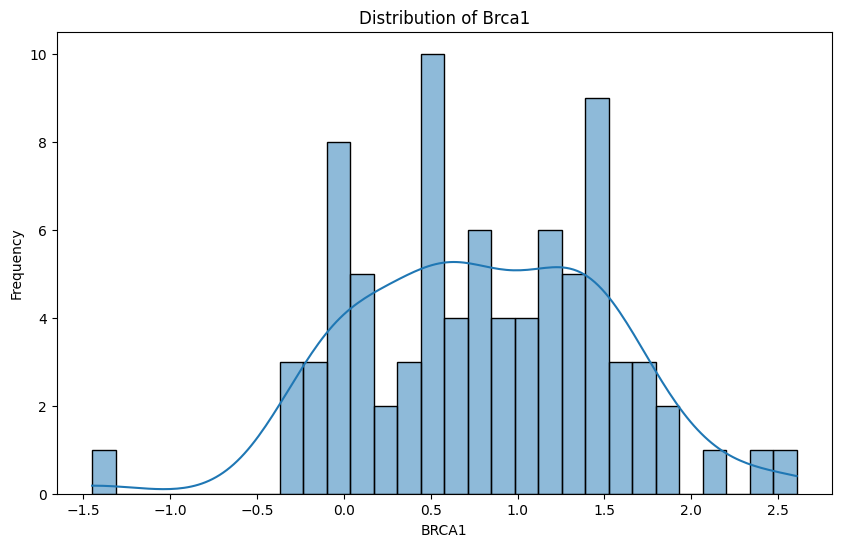

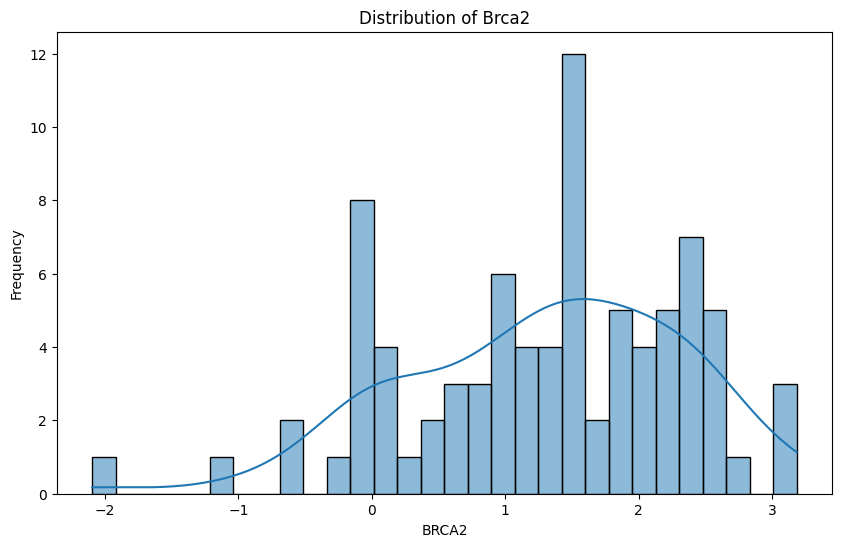

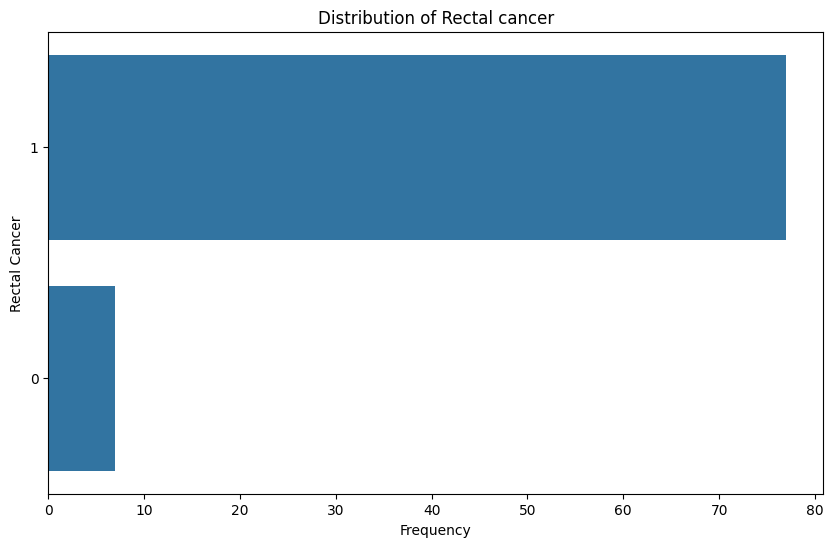

In [9]:
class DataVisualizer:
    def __init__(self, df):
        self.df = df

    def plot_distribution(self, column, numeric=True):
        plt.figure(figsize=(10, 6))
        if numeric:
            sns.histplot(self.df[column], kde=True, bins=30)
            plt.ylabel('Frequency')
        else:
            sns.countplot(y=column, data=self.df, order=self.df[column].value_counts().index)
            plt.xlabel('Frequency')
        plt.title(f'Distribution of {column.capitalize()}')
        plt.show()

    def analyze_distributions(self, numerical_columns, categorical_columns):
        for col in numerical_columns:
            self.plot_distribution(col, numeric=True)

        for col in categorical_columns:
            self.plot_distribution(col, numeric=False)

# Usage
visualizer = DataVisualizer(merged_data)

# For example, choose a few genes you are interested in for visualization:
interested_genes = [col for col in gene_list if 'brca' in col.lower()]
visualizer.analyze_distributions(numerical_columns=[condition_col, *interested_genes], 
                                 categorical_columns=[trait])

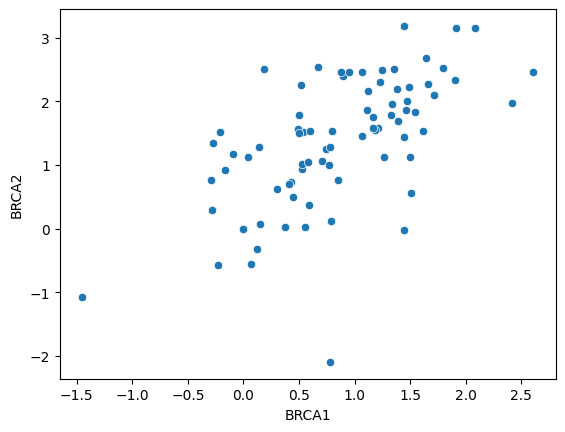

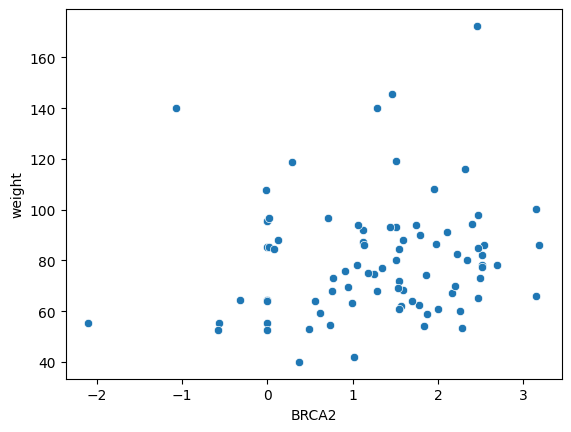

In [10]:
sns.scatterplot(data=merged_data, x='BRCA1', y='BRCA2')
plt.show()

sns.scatterplot(data=merged_data, x='BRCA2', y=condition_col)
plt.show()

### 3. Do regression & Cross Validation

In [11]:

def replace_infinity_with_nan(data):
    """Replace infinity values with NaN."""
    return np.where(np.isinf(data), np.nan, data)

def compute_normalization_params(data):
    """Compute mean and standard deviation, handling zero standard deviation."""
    mean = np.nanmean(data, axis=0)
    std = np.nanstd(data, axis=0)
    std[std <= 1e-8] = 1  # Avoid division by zero
    return mean, std

def normalize_data(data, mean, std):
    """Normalize data using given mean and standard deviation."""
    data_normalized = np.where(np.isnan(data), 0, (data - mean) / std)
    return data_normalized

def preprocess_data(X_train, X_test=None):
    X_train = replace_infinity_with_nan(X_train)
    mean_train, std_train = compute_normalization_params(X_train)

    X_train_normalized = normalize_data(X_train, mean_train, std_train)

    if X_test is not None:
        X_test = replace_infinity_with_nan(X_test)
        X_test[:, std_train <= 1] = 0  # Set zero std columns in test data to zero
        X_test_normalized = normalize_data(X_test, mean_train, std_train)
    else:
        X_test_normalized = None

    return X_train_normalized, X_test_normalized


In [12]:
def split_data(X, y, indices, train_indices, test_indices):
    """Split data into training and testing sets based on indices."""
    X_train, X_test = X[train_indices], X[test_indices]
    y_train, y_test = y[train_indices], y[test_indices]
    return X_train, X_test, y_train, y_test

def train_and_predict(X_train, y_train, X_test):
    """Train the model and make predictions."""
    var_select = VariableSelection()
    var_select.fit(X_train, y_train)
    predictions = var_select.predict(X_test)
    return predictions

def evaluate_accuracy(predictions, y_test):
    """Evaluate the accuracy of predictions."""
    binary_predictions = (predictions > 0.5).astype(int)
    return np.mean(binary_predictions == y_test)

def cross_validation(X, y, k=5):
    indices = np.arange(X.shape[0])
    np.random.shuffle(indices)

    fold_size = len(X) // k
    accuracies = []

    for i in range(k):
        test_indices = indices[i*fold_size : (i+1)*fold_size]
        train_indices = np.setdiff1d(indices, test_indices)

        X_train, X_test, y_train, y_test = split_data(X, y, indices, train_indices, test_indices)
        X_train, X_test = preprocess_data(X_train, X_test)

        predictions = train_and_predict(X_train, y_train, X_test)
        accuracy = evaluate_accuracy(predictions, y_test)
        accuracies.append(accuracy)

    return np.mean(accuracies), np.std(accuracies)

# Select relevant columns and convert to numpy array
y = merged_data[trait].values
X = merged_data.drop(columns=[trait]).values

cv_mean, cv_std = cross_validation(X, y)
print(f'The cross-validation accuracy is {(cv_mean * 100):.2f}% ± {(cv_std * 100):.2f}%')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/helpingMethods.py:49: RuntimeWarning: invalid value encountered in divide
  ts = beta / np.sqrt(var * sigma)


The cross-validation accuracy is 65.00% ± 33.95%


In [13]:

def prepare_data(merged_data, trait):
    """Prepare and preprocess the dataset."""
    y = merged_data[trait].values
    X = merged_data.drop(columns=[trait]).values
    X, _ = preprocess_data(X)  # Assuming preprocess_data is defined elsewhere
    return X, y

def fit_model(X, y):
    """Fit the VariableSelection model to the data."""
    var_select = VariableSelection()
    var_select.fit(X, y)
    return var_select

def get_model_output(var_select):
    """Retrieve and process the model's output."""
    coefficients = var_select.getBeta().reshape(-1).tolist()
    nlog_p_values = var_select.getNegLogP().reshape(-1).tolist()
    p_values = [np.exp(-p) for p in nlog_p_values]
    return coefficients, p_values

# Main execution
X, y = prepare_data(merged_data, trait)
var_select = fit_model(X, y)
coefficients, p_values = get_model_output(var_select)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/helpingMethods.py:49: RuntimeWarning: invalid value encountered in divide
  ts = beta / np.sqrt(var * sigma)


### 4. Discussion

In [14]:
import pandas as pd
from statsmodels.stats.multitest import multipletests


# Create a DataFrame for the regression results
regression_df = pd.DataFrame({
    'Variable': feature_cols,
    'Coefficient': coefficients,
    'p_value': p_values
})

# Extract information about the lifestyle condition's effect
condition_effect = regression_df.iloc[0]

# Report the effect of the lifestyle condition
print(f"Effect of the condition on the target variable:")
print(f"Variable: {condition}")
print(f"Coefficient: {condition_effect['Coefficient']:.4f}")
print(f"p-value: {condition_effect['p_value']:.4g}\n")

Effect of the condition on the target variable:
Variable: weight
Coefficient: -0.2065
p-value: 4.145e-06



In [15]:
threshold = 0.05
# Apply the Benjamini-Hochberg correction
rejected, corrected_p_values, _, _ = multipletests(regression_df['p_value'][1:], alpha=threshold, method='fdr_bh')

# Add the corrected p-values to the DataFrame (ignoring the first row which is the condition)
regression_df.loc[1:, 'corrected_p_value'] = corrected_p_values

# Now filter based on the corrected p-values
significant_genes = regression_df.loc[(regression_df.index > 0) & (regression_df['corrected_p_value'] < threshold)]
significant_genes_sorted = significant_genes.sort_values('corrected_p_value')

# Print and/or save your results as before
print(f"Genes with corrected p-value < {threshold}, affecting the trait {trait} conditional on the factor {condition}, sorted by corrected p-value:")
print(significant_genes_sorted[['Variable', 'Coefficient', 'corrected_p_value']].to_string(index=False))
print(f"\nFound {len(significant_genes_sorted)} significant genes with corrected p-value < {threshold}")
# Save this to a CSV file
significant_genes_sorted.to_csv('significant_genes_report_corrected.csv', index=False)

Genes with corrected p-value < 0.05, affecting the trait Rectal Cancer conditional on the factor weight, sorted by corrected p-value:
Empty DataFrame
Columns: [Variable, Coefficient, corrected_p_value]
Index: []

Found 0 significant genes with corrected p-value < 0.05
